In [3]:
import os
import json
import numpy as np
import pandas as pd

DATA_DIR = '../coleridgeinitiative-data/'

In [4]:
os.listdir(DATA_DIR)

['coleridgeinitiative-show-us-the-data.zip',
 'test',
 'train',
 'train.csv',
 'sample_submission.csv']

In [5]:
train_df = pd.read_csv(DATA_DIR + 'train.csv')
train_df.head()

,Id,pub_title,dataset_title,dataset_label,cleaned_label
0,d0fa7568-7d8e-4db9-870f-f9c6f668c17b,The Impact of Dual Enrollment on College Degre...,National Education Longitudinal Study,National Education Longitudinal Study,national education longitudinal study
1,2f26f645-3dec-485d-b68d-f013c9e05e60,Educational Attainment of High School Dropouts...,National Education Longitudinal Study,National Education Longitudinal Study,national education longitudinal study
2,c5d5cd2c-59de-4f29-bbb1-6a88c7b52f29,Differences in Outcomes for Female and Male St...,National Education Longitudinal Study,National Education Longitudinal Study,national education longitudinal study
3,5c9a3bc9-41ba-4574-ad71-e25c1442c8af,Stepping Stone and Option Value in a Model of ...,National Education Longitudinal Study,National Education Longitudinal Study,national education longitudinal study
4,c754dec7-c5a3-4337-9892-c02158475064,"Parental Effort, School Resources, and Student...",National Education Longitudinal Study,National Education Longitudinal Study,national education longitudinal study


In [6]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19661 entries, 0 to 19660
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Id             19661 non-null  object
 1   pub_title      19661 non-null  object
 2   dataset_title  19661 non-null  object
 3   dataset_label  19661 non-null  object
 4   cleaned_label  19661 non-null  object
dtypes: object(5)
memory usage: 768.1+ KB


In [21]:
dataset_titles = train_df['dataset_title'].unique()

for title in dataset_titles:
    tmp_df = train_df[train_df['dataset_title'] == title]
    labels = tmp_df['dataset_label'].unique().tolist()
    if len(labels) > 1:
        print('title: ', title)
        print('labels: ', labels)
        print()
# tmp_df

title:  NOAA Tide Gauge
labels:  ['NOAA tidal station', 'NOAA National Water Level Observation Network', 'NOAA water level station', 'National Water Level Observation Network', 'NOAA Tide Gauge', 'NOAA tide station']

title:  Sea, Lake, and Overland Surges from Hurricanes
labels:  ['SLOSH model', 'NOAA Sea, Lake, and Overland Surges from Hurricanes', 'NOAA storm surge inundation', 'National Weather Service (NWS) storm surge risk']

title:  Coastal Change Analysis Program
labels:  ['NOAA C-CAP', 'National Oceanic and Atmospheric Administration C-CAP', 'Coastal Change Analysis Program', 'Coastal Change Analysis Program land cover']

title:  Aging Integrated Database (AGID)
labels:  ['Aging Integrated Database (AGID)', 'Aging Integrated Database']

title:  Alzheimer's Disease Neuroimaging Initiative (ADNI)
labels:  ['Alzheimers Disease Neuroimaging Initiative', 'ADNI', "Alzheimer's Disease Neuroimaging Initiative (ADNI)"]

title:  Baltimore Longitudinal Study of Aging (BLSA)
labels:  ['Ba

In [156]:
len(dataset_titles)

45

In [154]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go

%matplotlib inline

In [106]:
df_titles_count = train_df['dataset_title'].value_counts().to_frame()
df_titles_count = df_titles_count.reset_index()
df_titles_count.columns = ['title', 'count of dataset title']


fig = go.Figure(data = [go.Table(
                header = dict(values=df_titles_count.columns, align = 'center', font_size = 11),
                cells = dict(values = df_titles_count.values.T, align = 'center', font_size = 11)
                )])
fig.update_layout(title = {'text':'count of dataset title', 'x':0.5, 'xanchor': 'center'}, height = 600)
fig.layout.title.font.size = 25
fig.show()

# EDA for pub_title

In [131]:
from wordcloud import WordCloud, STOPWORDS

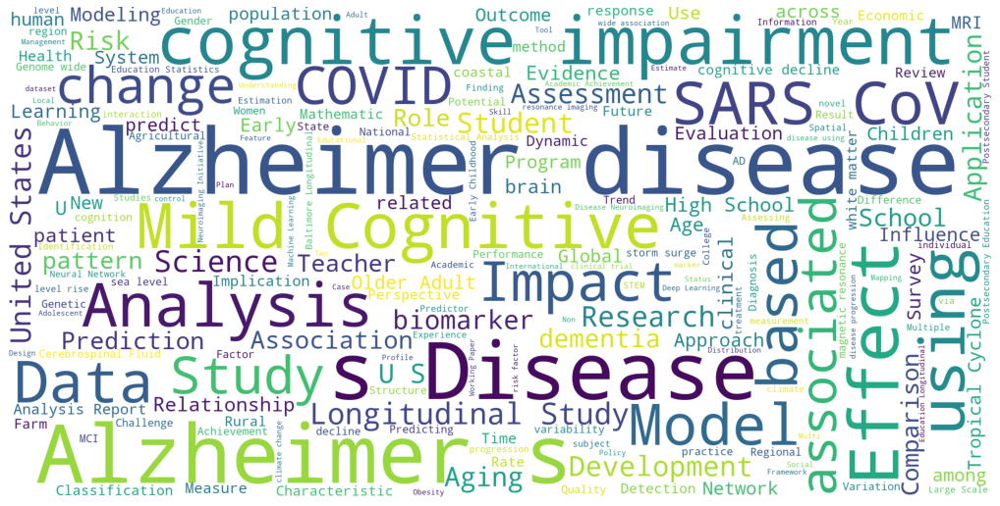

In [142]:
words_in_titles = list(train_df.pub_title.str.split(expand = True).stack())
wordcloud = WordCloud(stopwords = STOPWORDS, 
                     background_color='white',
                     width = 2000,
                     height = 1000,
                     ).generate(' '.join(words_in_titles))
plt.figure(1, figsize = (18, 12))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

In [149]:
def show_wordcloud(title):
    print('wordcloud of ' + title)
    df = train_df[train_df['dataset_title'] == title]
    words = list(df.pub_title.str.split(expand = True).stack())
    wordcloud = WordCloud(stopwords=STOPWORDS,
                         background_color='white',
                         width = 2000,
                         height = 1000).generate(' '.join(words))
    plt.figure(1, figsize=(18, 12))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.show()

wordcloud of National Education Longitudinal Study


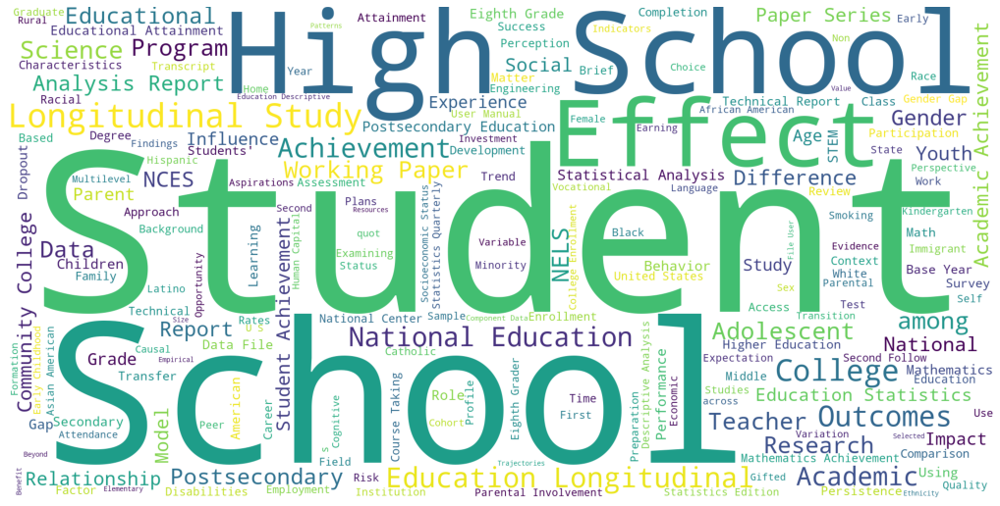

wordcloud of NOAA Tide Gauge


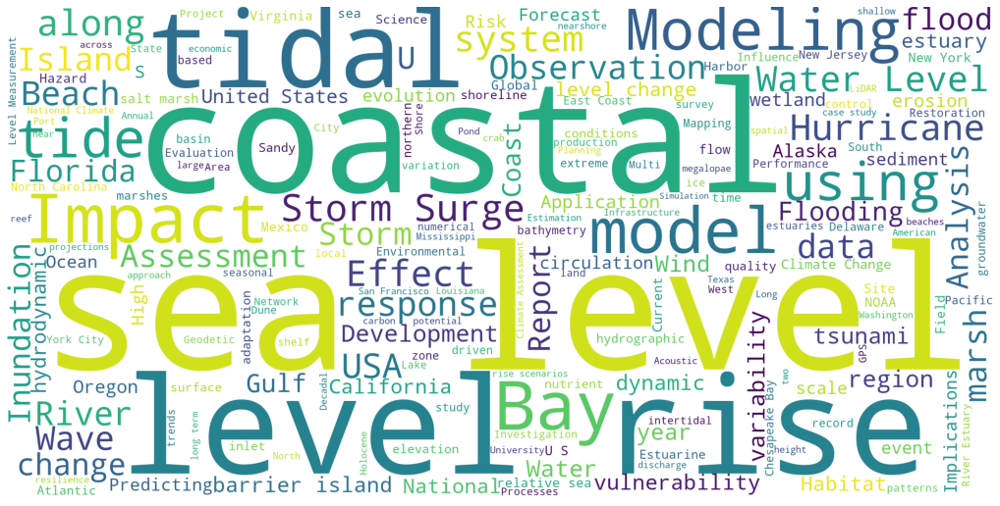

wordcloud of Sea, Lake, and Overland Surges from Hurricanes


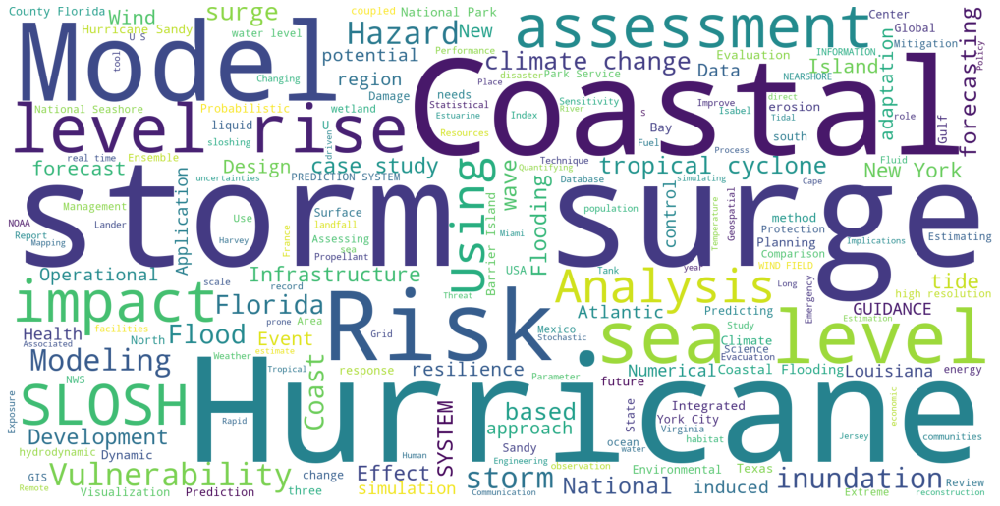

wordcloud of Coastal Change Analysis Program


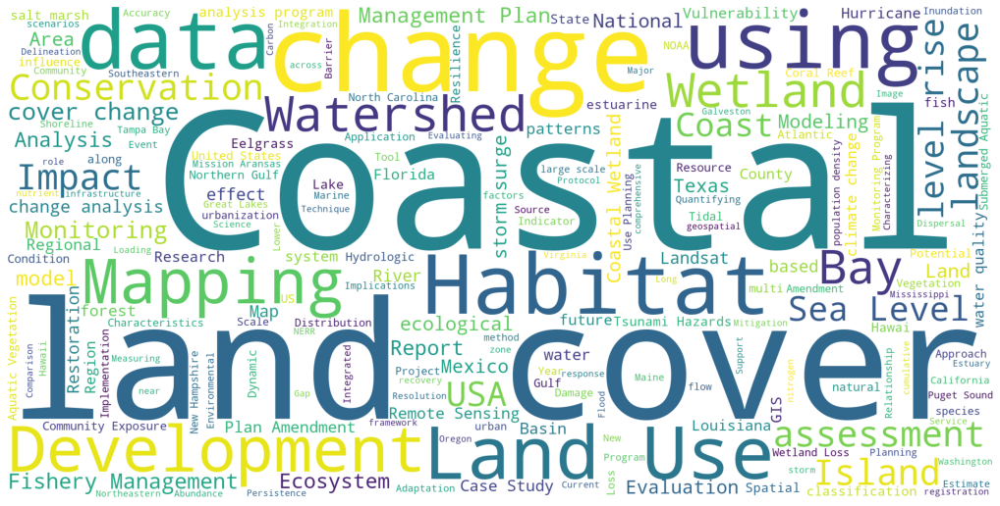

wordcloud of Aging Integrated Database (AGID)


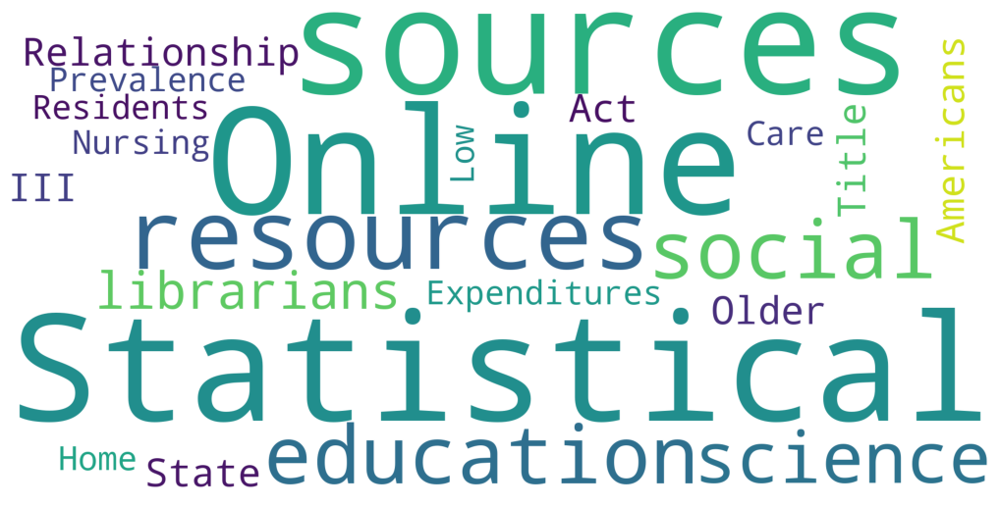

wordcloud of Alzheimer's Disease Neuroimaging Initiative (ADNI)


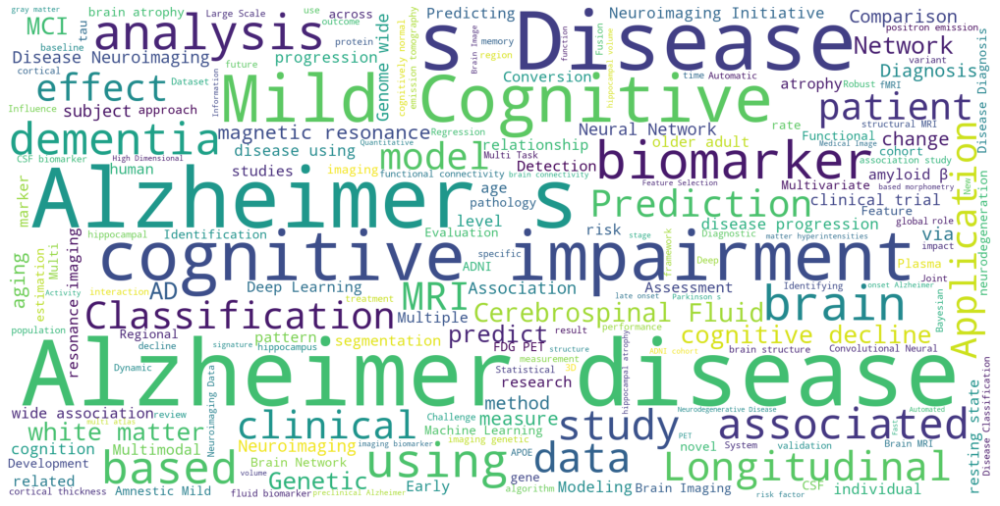

wordcloud of Baltimore Longitudinal Study of Aging (BLSA)


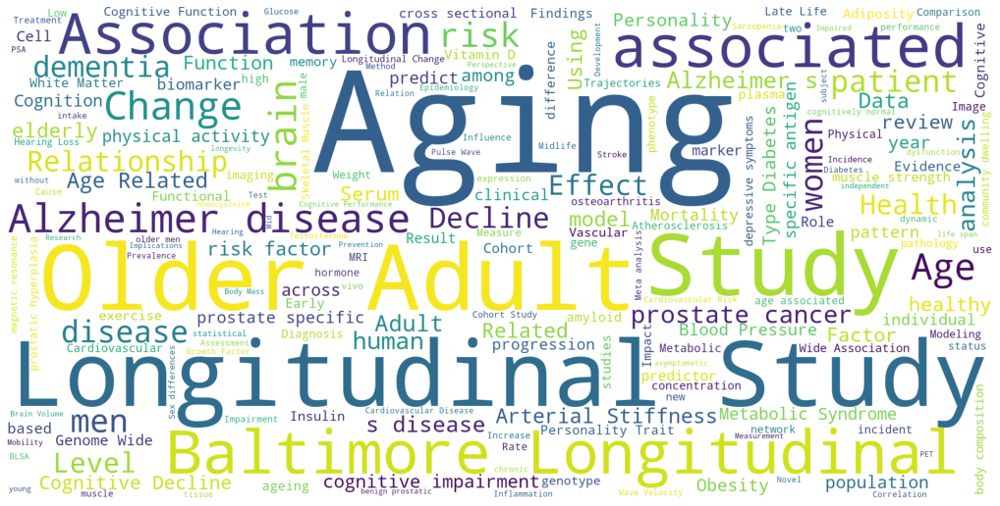

wordcloud of Agricultural Resource Management Survey


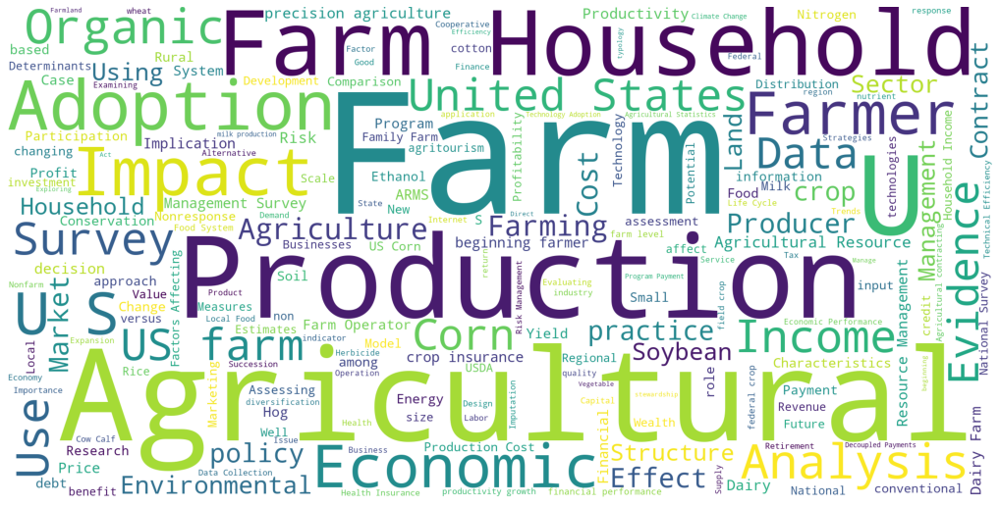

wordcloud of Beginning Postsecondary Student


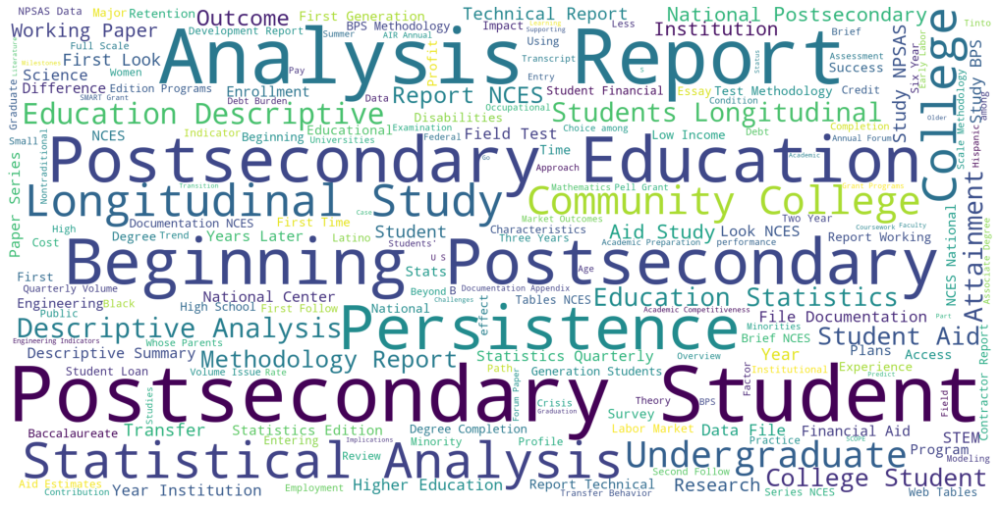

wordcloud of The National Institute on Aging Genetics of Alzheimer's Disease Data Storage Site (NIAGADS)


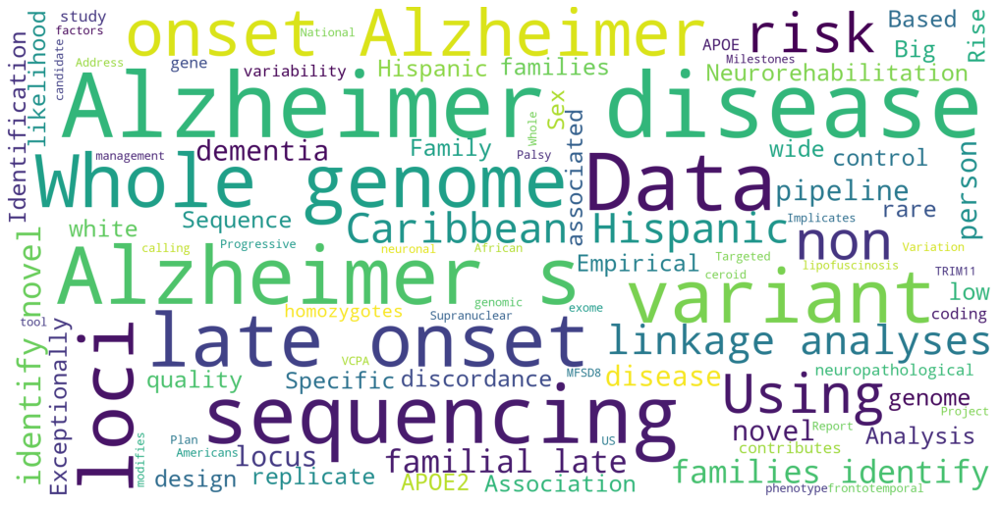

wordcloud of Common Core of Data


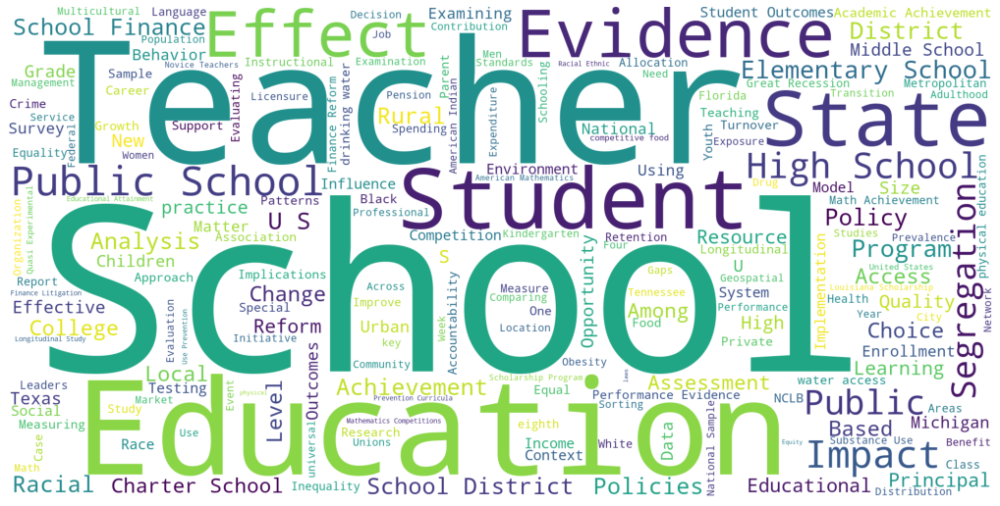

wordcloud of Survey of Industrial Research and Development


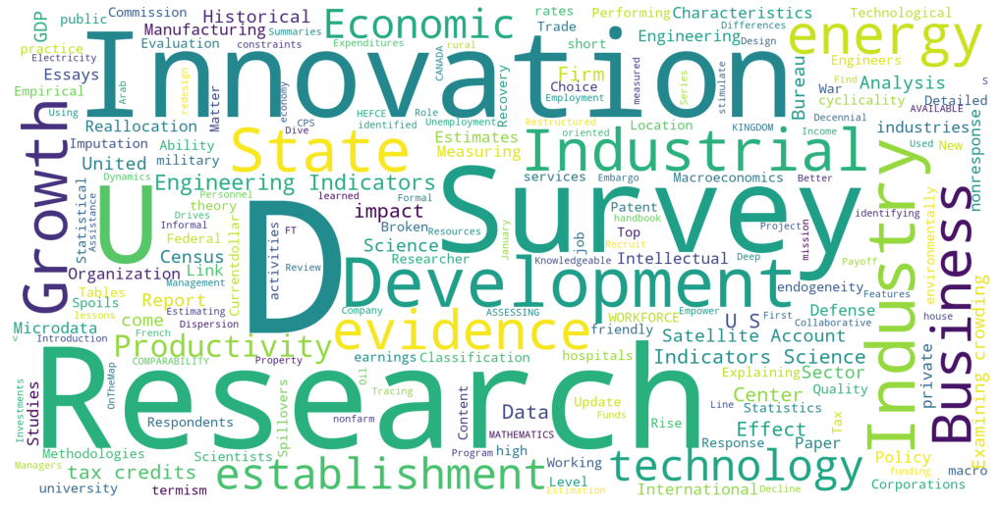

wordcloud of Baccalaureate and Beyond


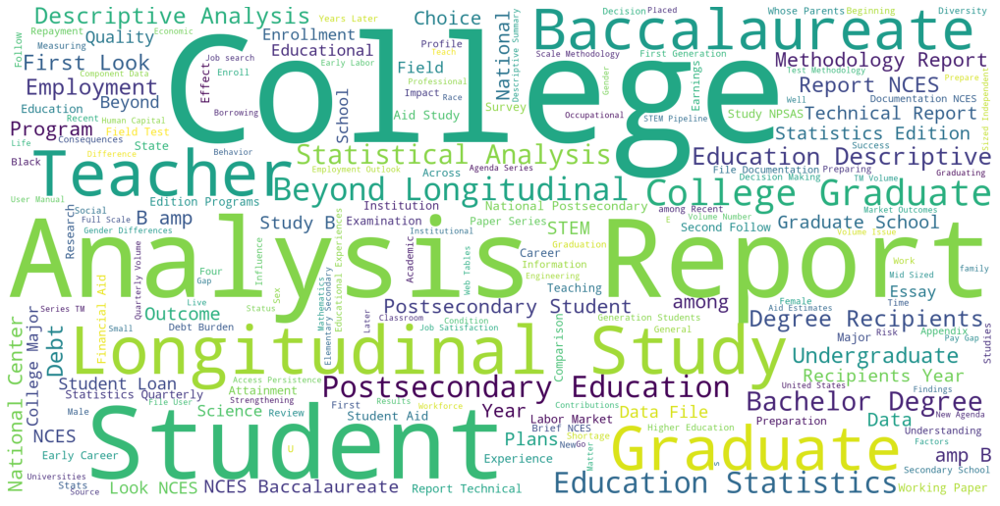

wordcloud of International Best Track Archive for Climate Stewardship


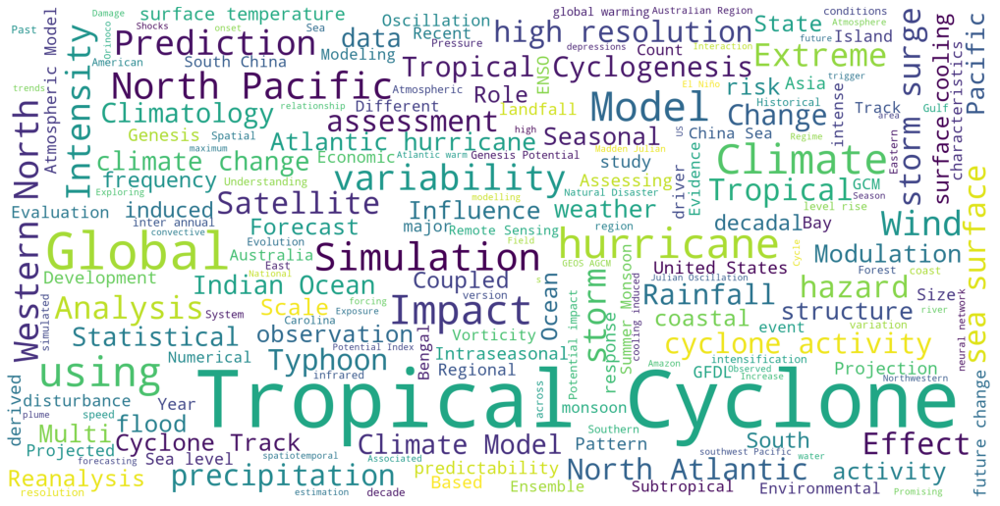

wordcloud of National Teacher and Principal Survey


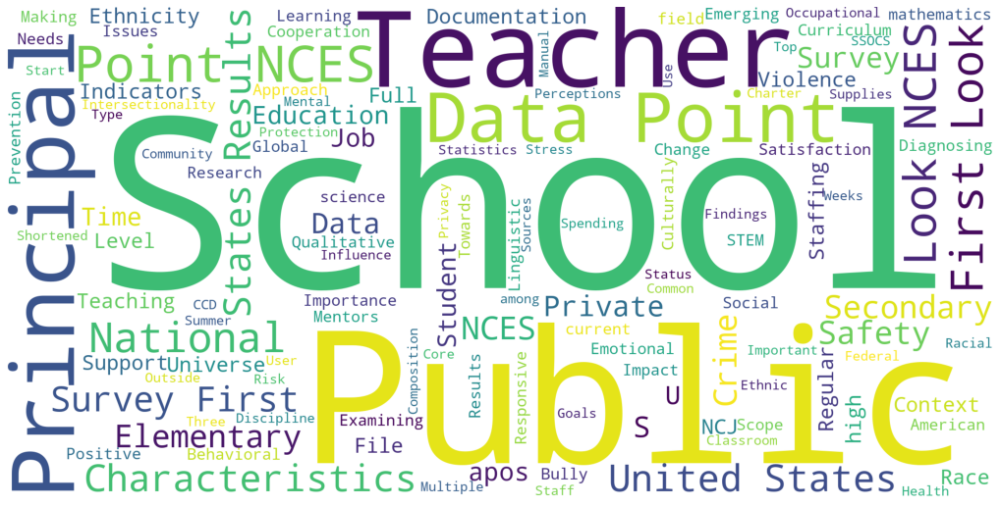

wordcloud of Higher Education Research and Development Survey


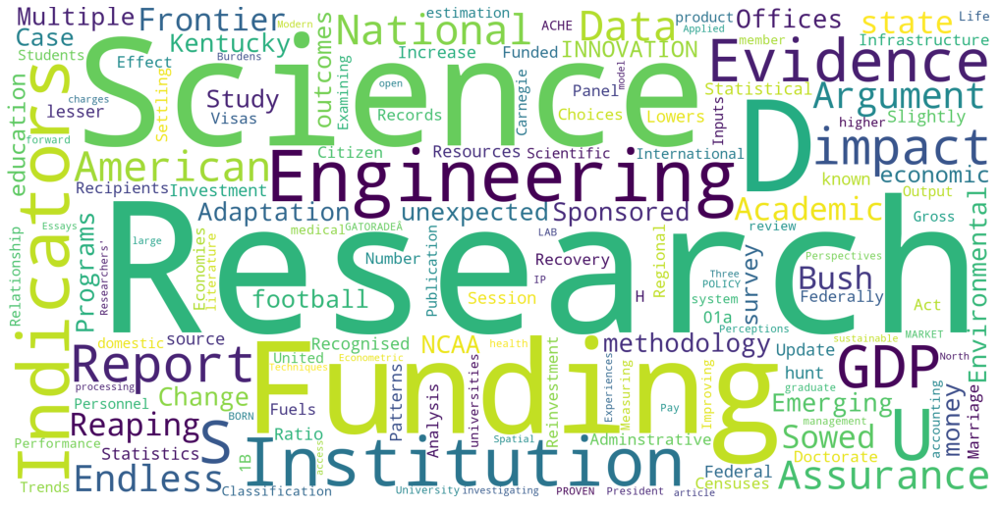

wordcloud of Survey of Earned Doctorates


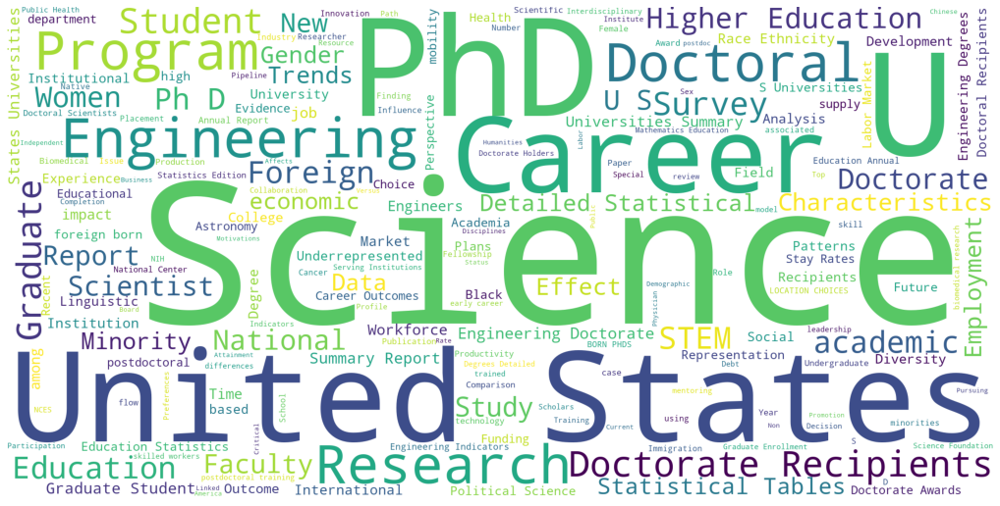

wordcloud of School Survey on Crime and Safety


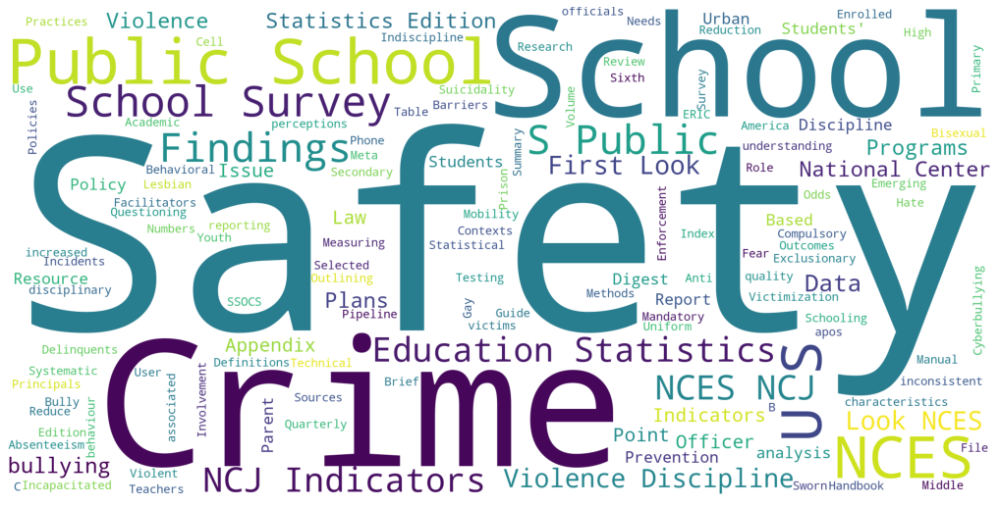

wordcloud of World Ocean Database


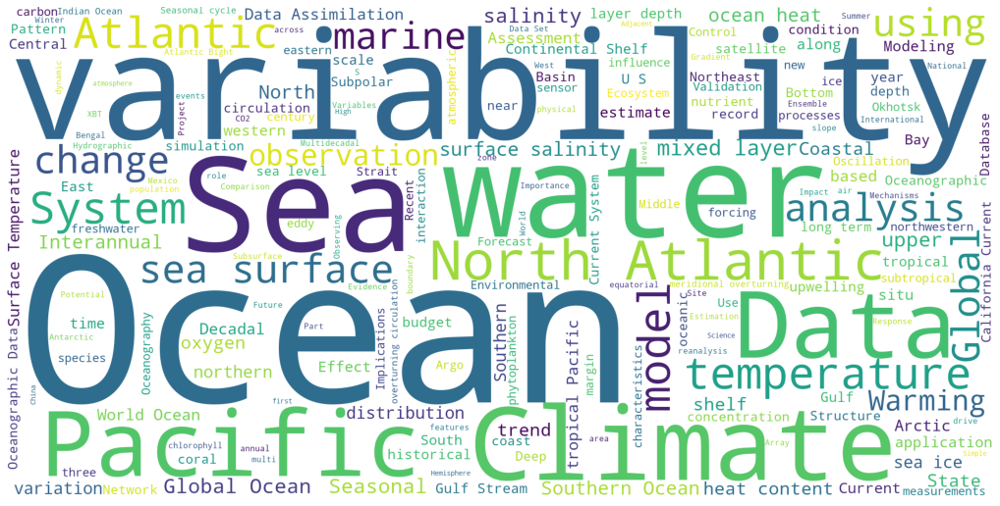

wordcloud of Program for the International Assessment of Adult Competencies


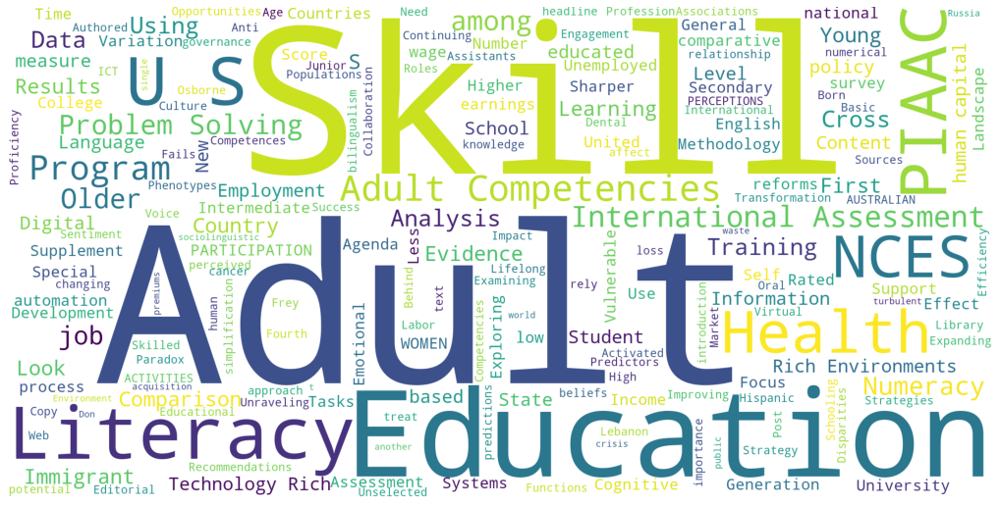

wordcloud of Early Childhood Longitudinal Study


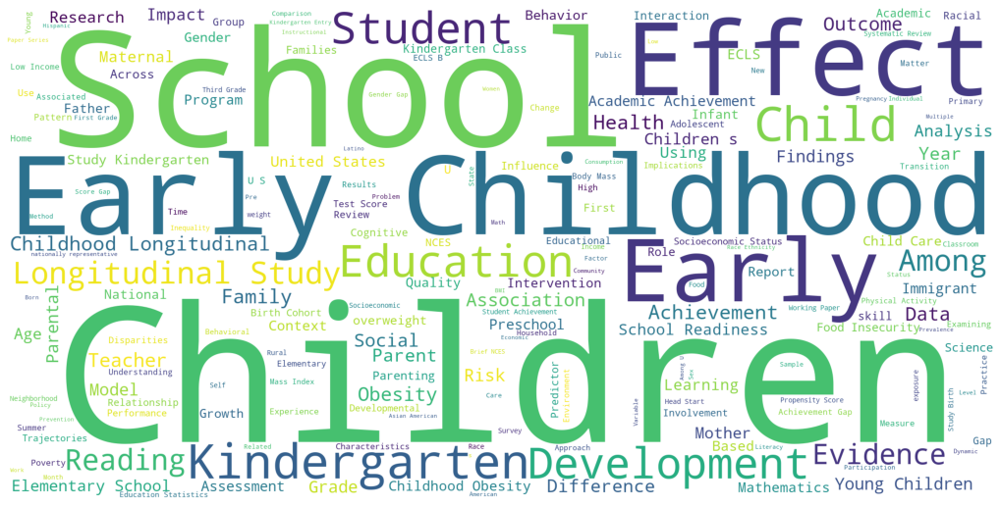

wordcloud of Survey of Graduate Students and Postdoctorates in Science and Engineering


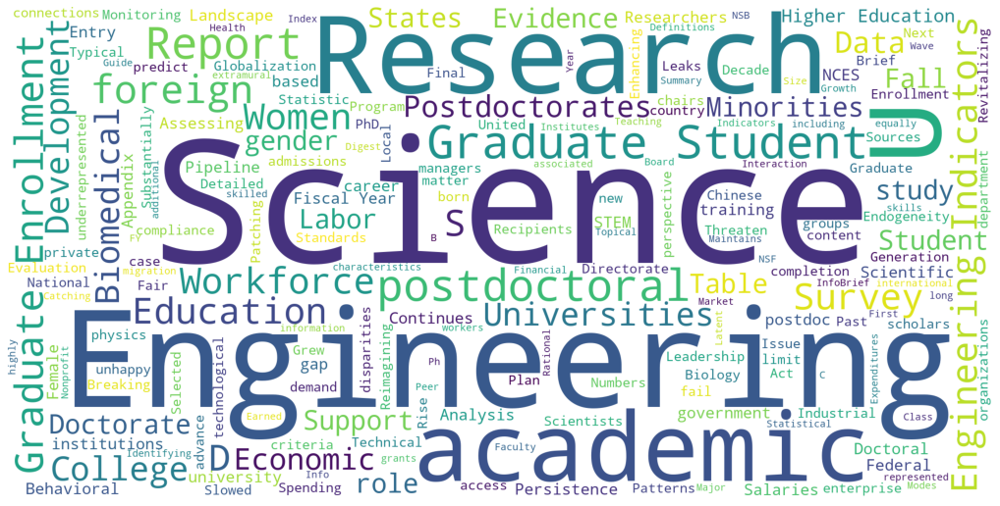

wordcloud of Trends in International Mathematics and Science Study


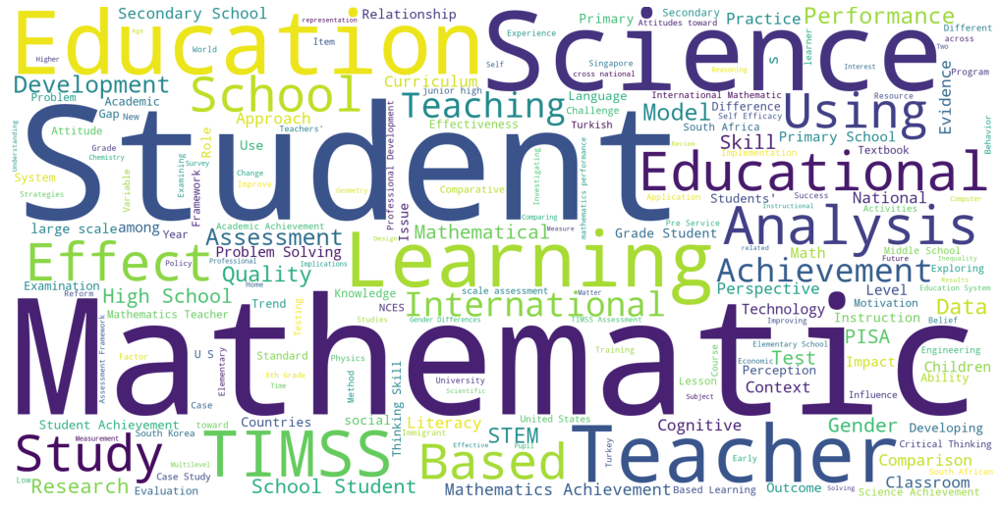

wordcloud of Education Longitudinal Study


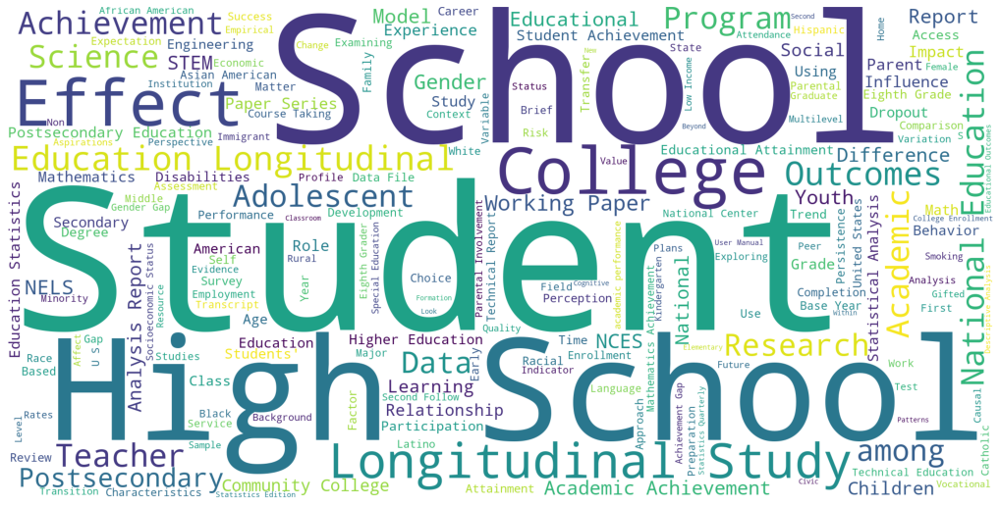

wordcloud of Optimum Interpolation Sea Surface Temperature


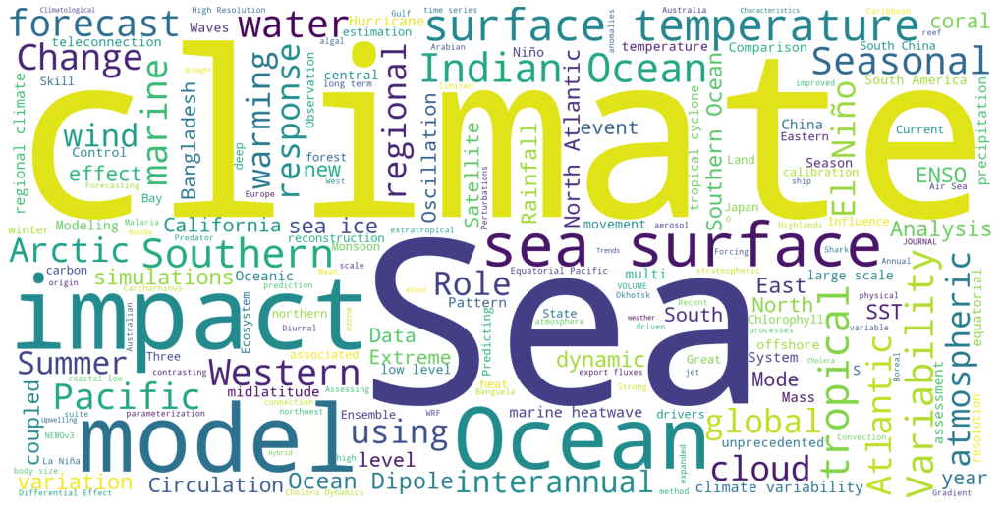

wordcloud of National Assessment of Education Progress


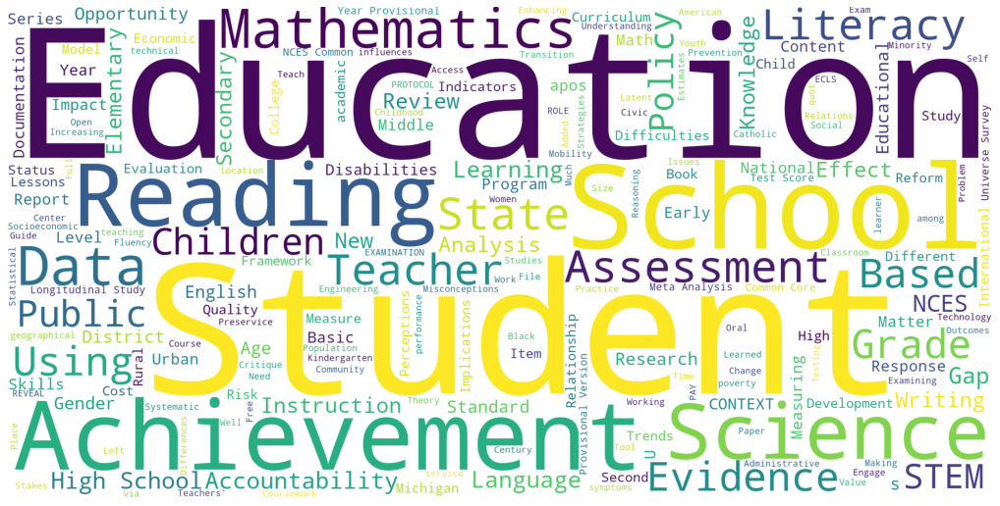

wordcloud of High School Longitudinal Study


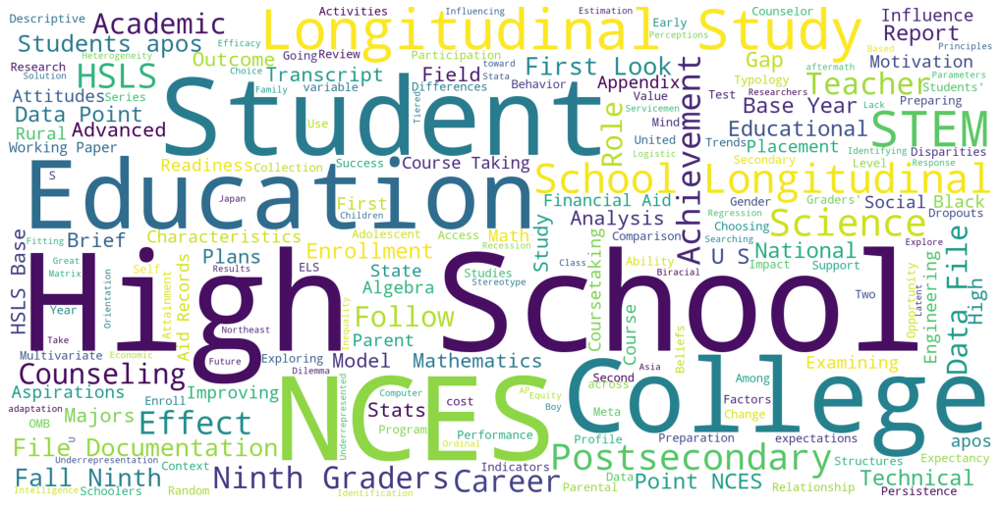

wordcloud of Survey of Doctorate Recipients


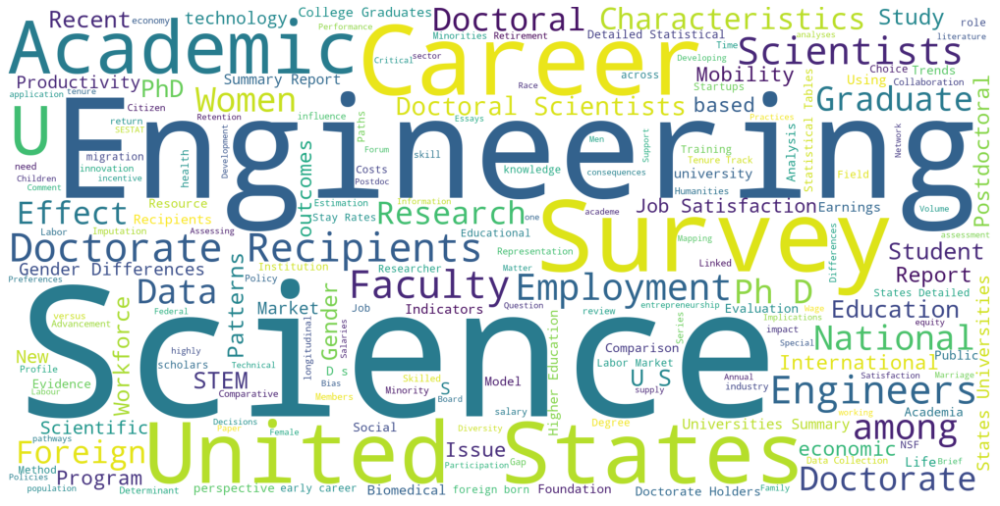

wordcloud of Rural-Urban Continuum Codes


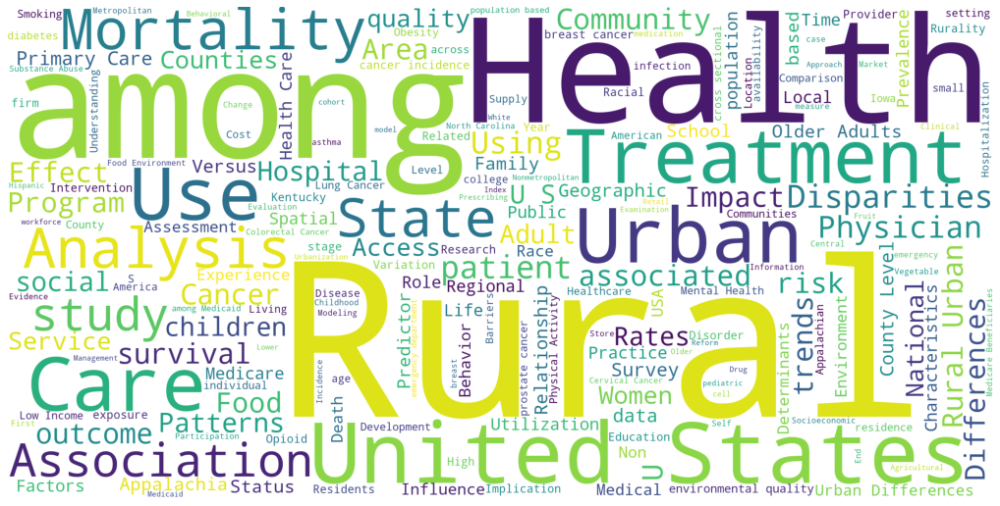

wordcloud of Survey of Science and Engineering Research Facilities


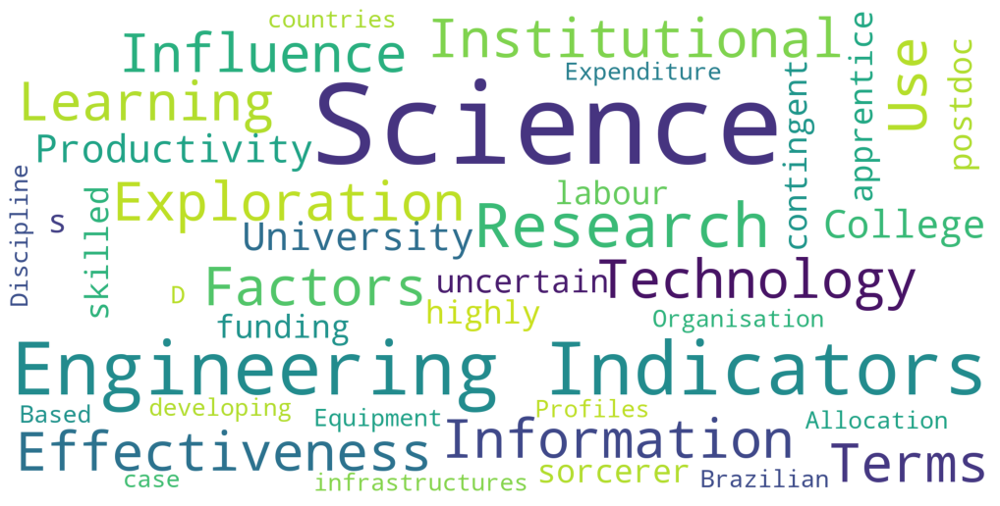

wordcloud of FFRDC Research and Development Survey


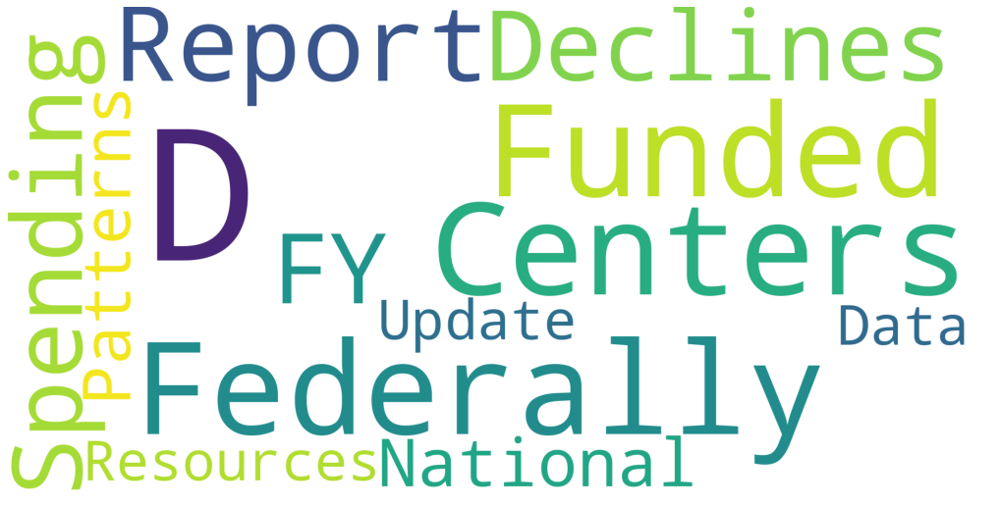

wordcloud of Survey of State Government Research and Development


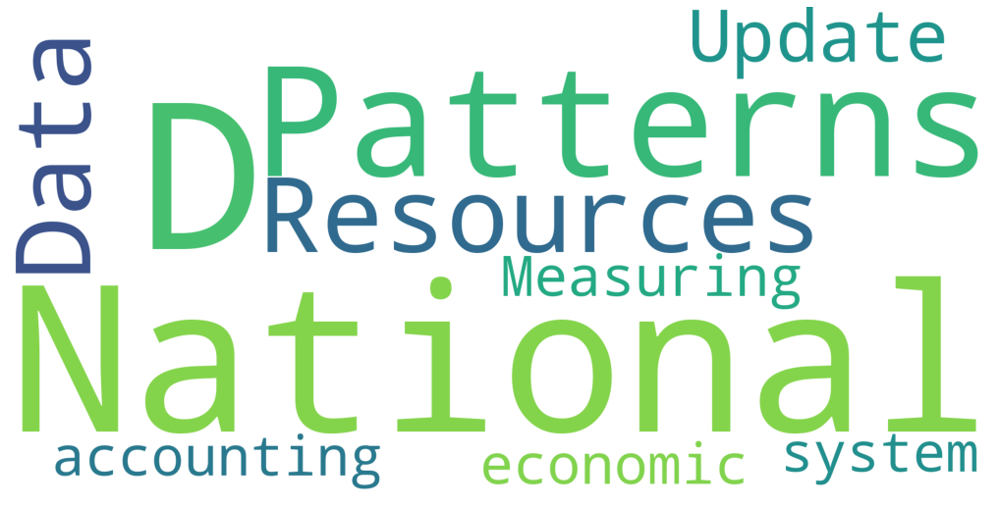

wordcloud of Advanced National Seismic System (ANSS) Comprehensive Catalog (ComCat)


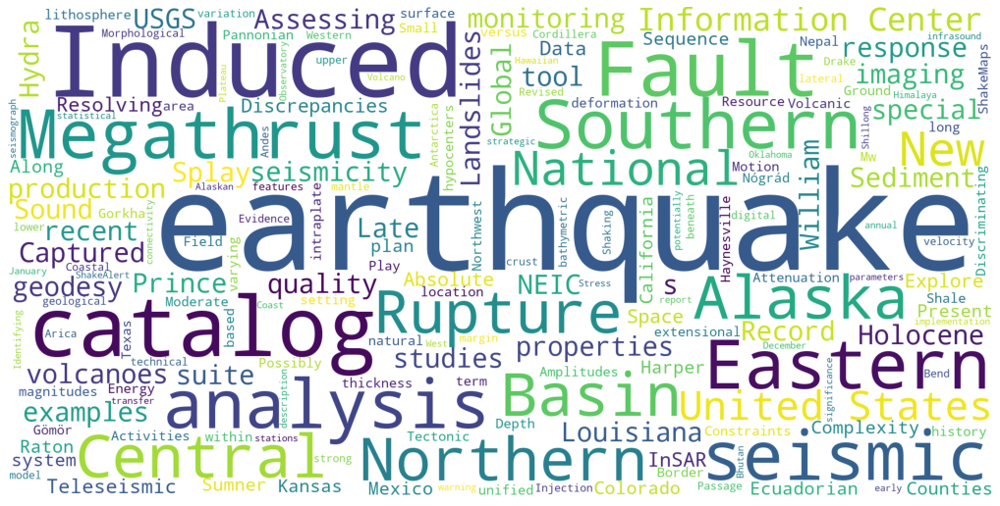

wordcloud of Census of Agriculture


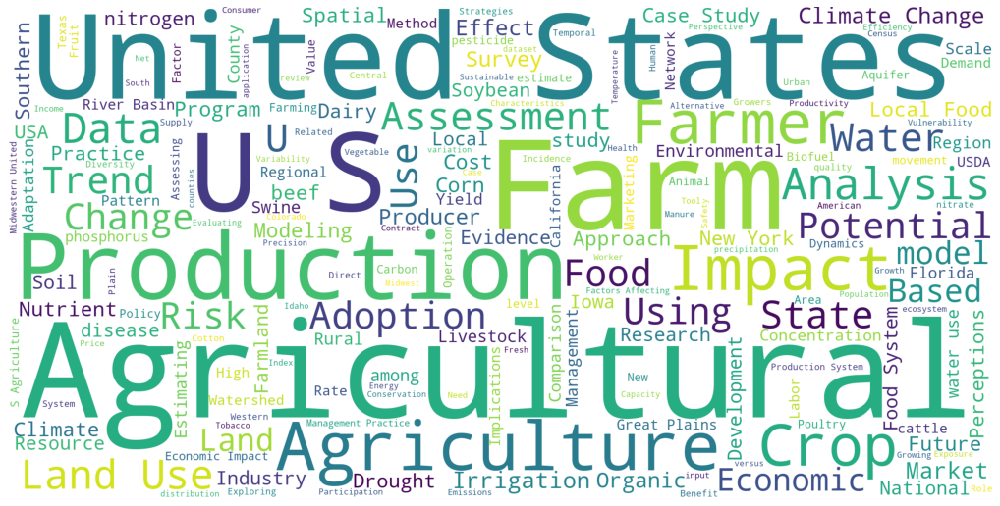

wordcloud of North American Breeding Bird Survey (BBS)


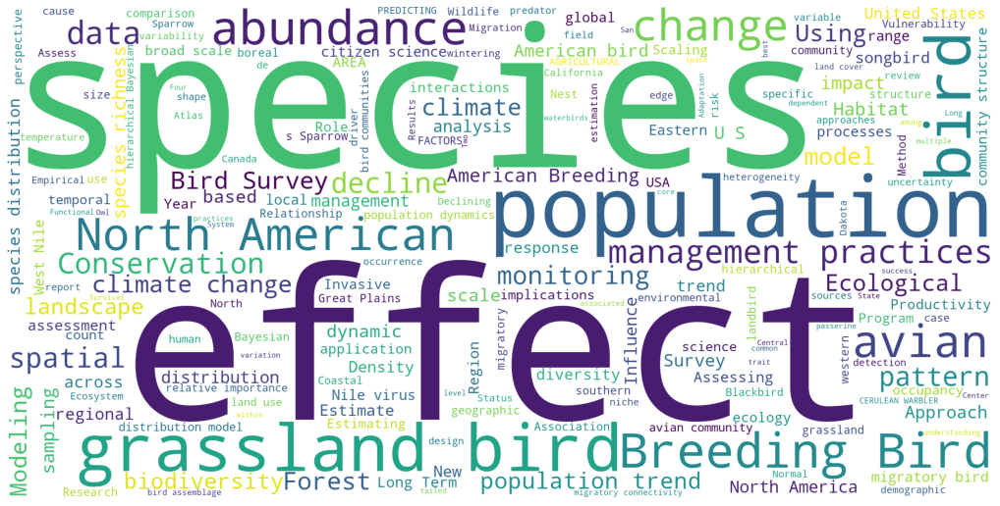

wordcloud of COVID-19 Open Research Dataset (CORD-19)


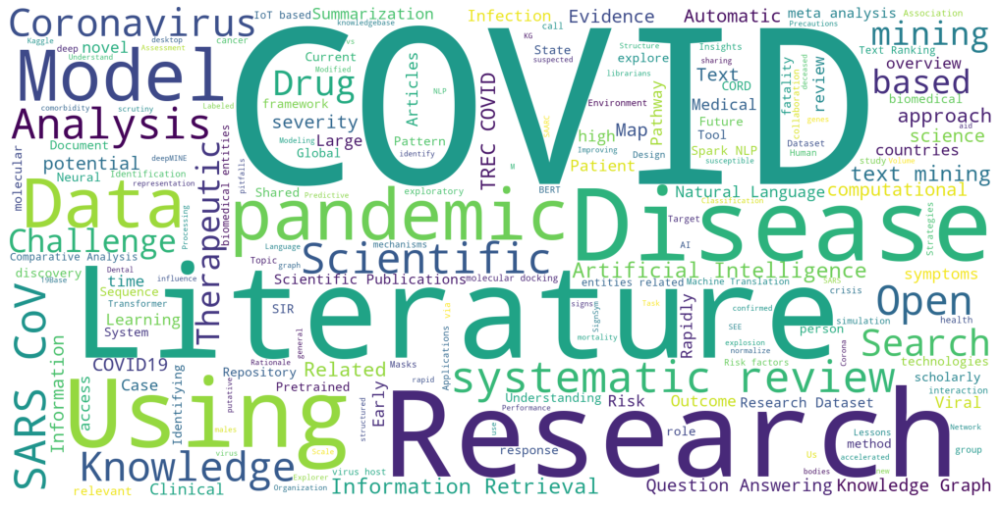

wordcloud of Complexity Science Hub COVID-19 Control Strategies List (CCCSL)


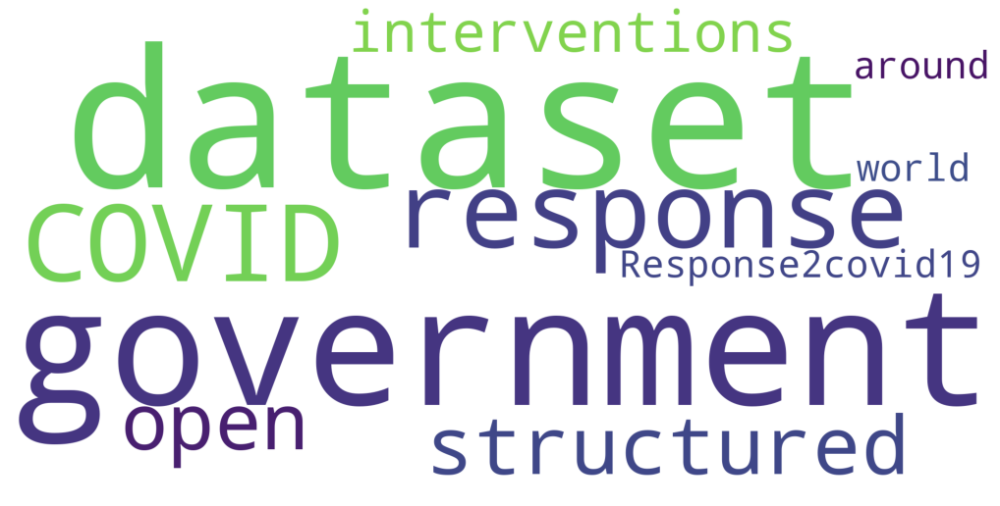

wordcloud of Our World in Data COVID-19 dataset


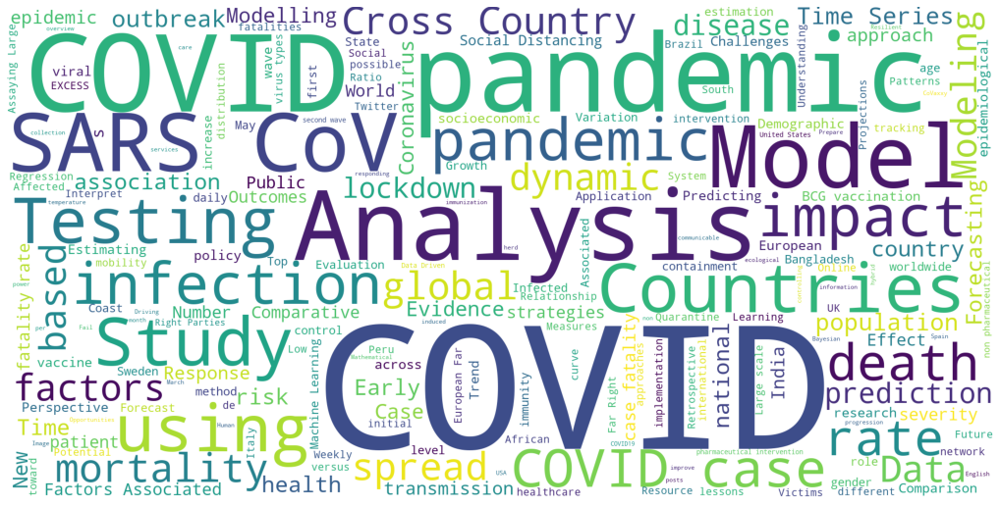

wordcloud of COVID-19 Precision Medicine Analytics Platform Registry (JH-CROWN)


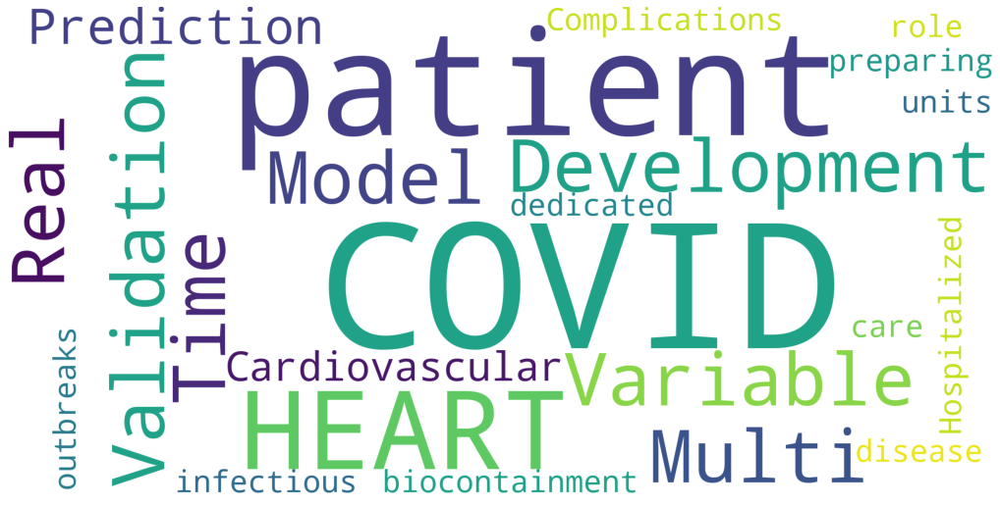

wordcloud of Characterizing Health Associated Risks, and Your Baseline Disease In SARS-COV-2 (CHARYBDIS)


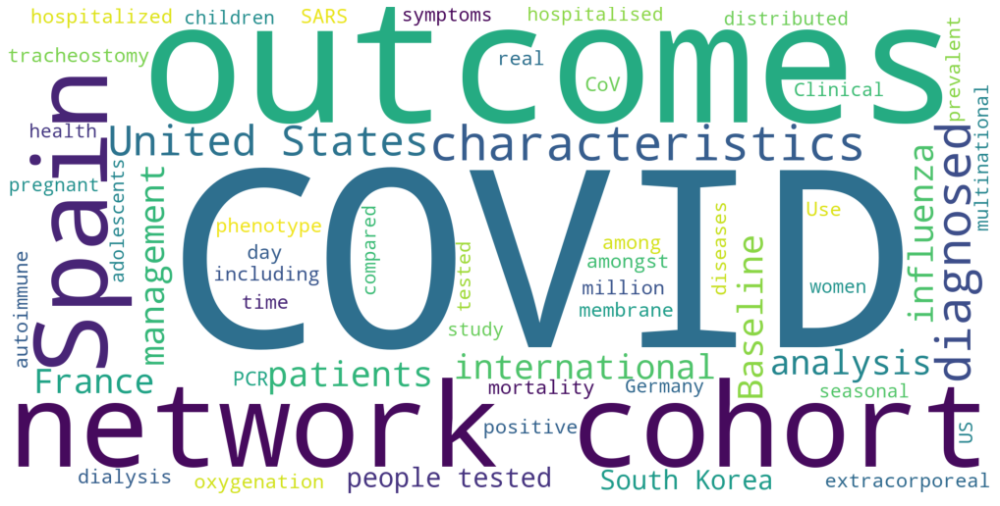

wordcloud of COVID-19 Deaths data


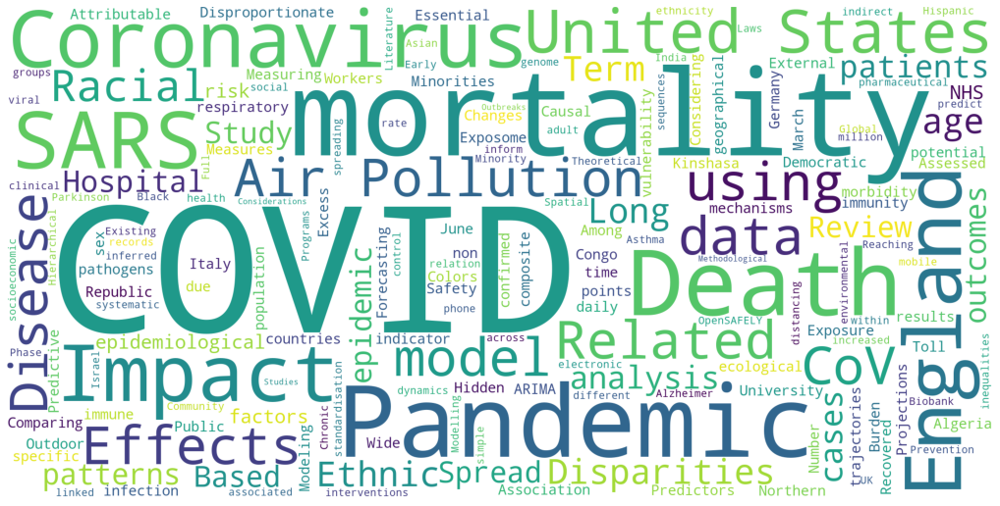

wordcloud of SARS-CoV-2 genome sequence


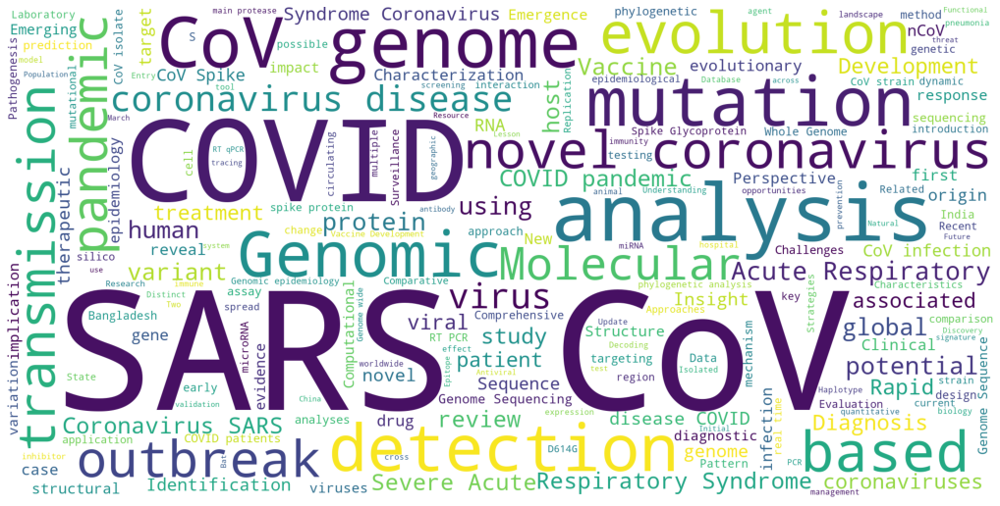

wordcloud of COVID-19 Image Data Collection


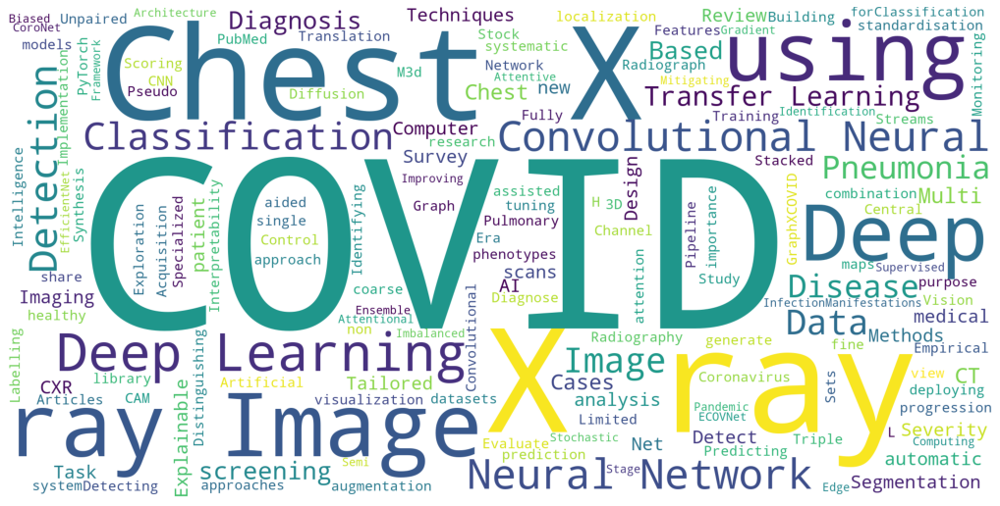

wordcloud of RSNA International COVID-19 Open Radiology Database (RICORD)


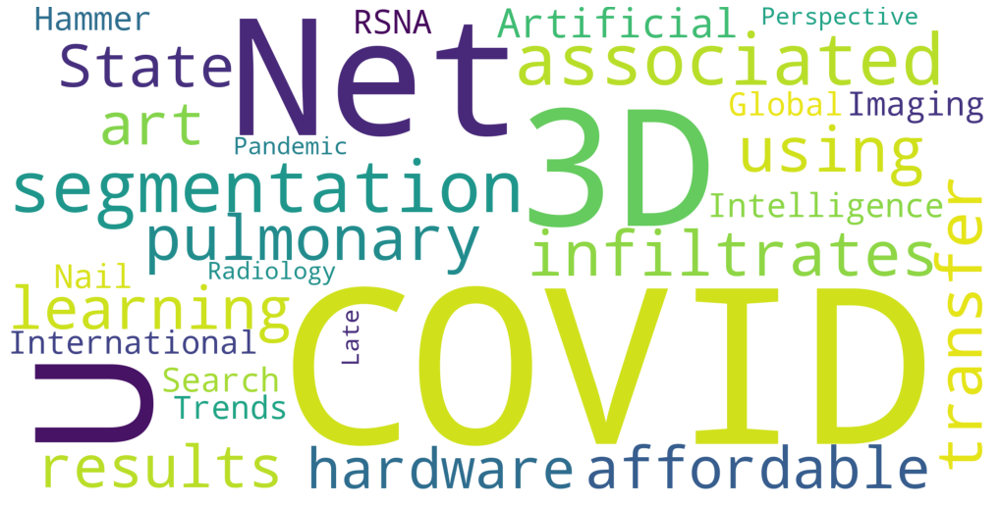

wordcloud of CAS COVID-19 antiviral candidate compounds dataset


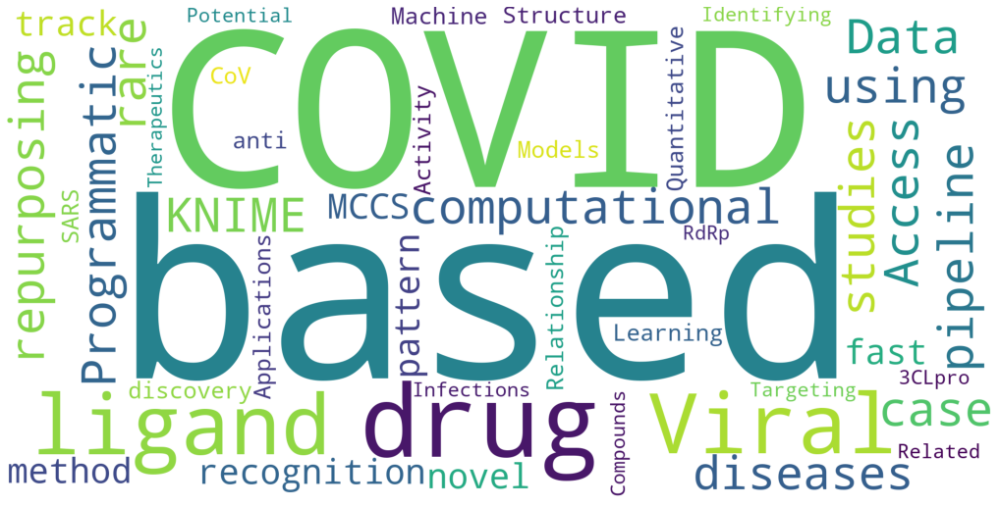

In [155]:
for dataset_title in dataset_titles:
    show_wordcloud(dataset_title)

# make data for ML

論文の内容が記録されているjsonファイルを読み込んで色々やる

In [162]:
from glob import glob
import json

In [163]:
train_files = glob(DATA_DIR + 'train/*.json')
test_files = glob(DATA_DIR + 'test/*.json')

In [164]:
test_files

['../coleridgeinitiative-data/test/8e6996b4-ca08-4c0b-bed2-aaf07a4c6a60.json',
 '../coleridgeinitiative-data/test/2100032a-7c33-4bff-97ef-690822c43466.json',
 '../coleridgeinitiative-data/test/2f392438-e215-4169-bebf-21ac4ff253e1.json',
 '../coleridgeinitiative-data/test/3f316b38-1a24-45a9-8d8c-4e05a42257c6.json']

In [179]:
test = pd.read_json(train_files[0])
test

,section_title,text
0,,"On 26 January 2010, at an ordinary airport hot..."
1,PART 2: CAN ALZHEIMER'S PREVENTION INITIATIVE ...,Reiman was not alone in thinking about such tr...
2,PART 3: TRIALS IN COLOMBIA AND THE U.S. FOR TH...,During two recent all-day discussions with aca...
3,"PART 4: FOR SHARED PREVENTION TRIALS, DEVIL IS...","In Phoenix, a roomful of senior industry and a..."
4,"Drug Selection: Can We Have Privacy, Please!",If anyone was hoping that representatives from...
5,Safety: How Much Is Enough?,The question of how much safety data are suffi...
6,Efficacy: How Little Is Enough?,Must a drug have shown efficacy in clinical tr...
7,Dose: Still a Black Box,Industry scientists suggested that a pre-sympt...
8,"PART 5: MAKING TRIALS WORK FOR PATIENT, SPONSO...",Exactly how to correctly fashion a pre-symptom...


In [180]:
test['Id'] = train_files[0][len(DATA_DIR+"train/"):].replace('.json', "")
test

,section_title,text,Id
0,,"On 26 January 2010, at an ordinary airport hot...",0213936a-340f-47cf-a5e6-2ca353343a77
1,PART 2: CAN ALZHEIMER'S PREVENTION INITIATIVE ...,Reiman was not alone in thinking about such tr...,0213936a-340f-47cf-a5e6-2ca353343a77
2,PART 3: TRIALS IN COLOMBIA AND THE U.S. FOR TH...,During two recent all-day discussions with aca...,0213936a-340f-47cf-a5e6-2ca353343a77
3,"PART 4: FOR SHARED PREVENTION TRIALS, DEVIL IS...","In Phoenix, a roomful of senior industry and a...",0213936a-340f-47cf-a5e6-2ca353343a77
4,"Drug Selection: Can We Have Privacy, Please!",If anyone was hoping that representatives from...,0213936a-340f-47cf-a5e6-2ca353343a77
5,Safety: How Much Is Enough?,The question of how much safety data are suffi...,0213936a-340f-47cf-a5e6-2ca353343a77
6,Efficacy: How Little Is Enough?,Must a drug have shown efficacy in clinical tr...,0213936a-340f-47cf-a5e6-2ca353343a77
7,Dose: Still a Black Box,Industry scientists suggested that a pre-sympt...,0213936a-340f-47cf-a5e6-2ca353343a77
8,"PART 5: MAKING TRIALS WORK FOR PATIENT, SPONSO...",Exactly how to correctly fashion a pre-symptom...,0213936a-340f-47cf-a5e6-2ca353343a77


In [194]:
df = pd.DataFrame()
for train_file in train_files:
    tmp_df = pd.read_json(train_file)
    ID = train_file[len(DATA_DIR+"train/"):].replace('.json', "")
    tmp_df['Id'] = ID
    df = df.append(tmp_df)
df = df.reset_index().drop(columns = 'index')

In [195]:
df

,section_title,text,Id
0,,"On 26 January 2010, at an ordinary airport hot...",0213936a-340f-47cf-a5e6-2ca353343a77
1,PART 2: CAN ALZHEIMER'S PREVENTION INITIATIVE ...,Reiman was not alone in thinking about such tr...,0213936a-340f-47cf-a5e6-2ca353343a77
2,PART 3: TRIALS IN COLOMBIA AND THE U.S. FOR TH...,During two recent all-day discussions with aca...,0213936a-340f-47cf-a5e6-2ca353343a77
3,"PART 4: FOR SHARED PREVENTION TRIALS, DEVIL IS...","In Phoenix, a roomful of senior industry and a...",0213936a-340f-47cf-a5e6-2ca353343a77
4,"Drug Selection: Can We Have Privacy, Please!",If anyone was hoping that representatives from...,0213936a-340f-47cf-a5e6-2ca353343a77
...,...,...,...
258709,Environmental input variability onP in wind-dr...,The acoustic pressure field calculated by CRAM...,e6f8d6c1-f7ec-43bd-849f-f5a0382a2e1a
258710,Influence of ocean noise onP,Ocean noise has a large influence onP. The noi...,e6f8d6c1-f7ec-43bd-849f-f5a0382a2e1a
258711,IV. MODEL/DATA COMPARISON,Given the non-overlapping coverage and omnidir...,e6f8d6c1-f7ec-43bd-849f-f5a0382a2e1a
258712,V. DISCUSSION,The uncertainties inP from single fixed sensor...,e6f8d6c1-f7ec-43bd-849f-f5a0382a2e1a
